In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# dataset generation without optical flow

In [ ]:
data_file_name = "FallDataset/"
train_x = []
train_y = []
for folder in os.listdir(data_file_name)[:4]:
    for file in os.listdir(os.path.join(data_file_name,folder,folder,"Videos")):
        print(os.path.join(data_file_name,folder,folder,"Videos",file),"\t\t\t\t\t\t\t",end="\r")
        cap = cv2.VideoCapture(os.path.join(data_file_name,folder,folder,"Videos",file))
        temp_info = pd.read_csv(os.path.join(data_file_name,folder,folder,"Annotation_files",file.replace(".avi",".txt")),header=None, sep='\n')
        temp = []
        for i in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))):
            _,frame = cap.read()
            temp += [frame if frame.shape == (240,320,3) else cv2.resize(frame,(320,240))]
        temp = np.array(temp)
        for i,x in enumerate(temp[:-25]):
            train_x += [temp[i:i+25]]
            train_y += [1 if i<=int(temp_info.iloc[0])<=i+25 and int(temp_info.iloc[1])!=0 else 0]
# train_x = np.array(train_x)
# train_y = np.array(train_y)

In [ ]:
import random

data = list(zip(train_x, train_y))

random.shuffle(data)

train_x, train_y = zip(*data)

In [ ]:
for i, ix in enumerate(range(0,len(data), 10)[:-1]):
#     print(i)
    temp_x = np.array(train_x[ix:ix+10])
    temp_y = np.array(train_y[ix:ix+10])
    np.save("xx_"+str(i),temp_x)
    np.save("yy_"+str(i),temp_y)

# dataset generation with optical flow

In [2]:
import time
data_file_name = "FallDataset/"
train_x = []
train_y = []
tt = 0
aa = 1
for folder in os.listdir(data_file_name)[:4]:
    for file in os.listdir(os.path.join(data_file_name,folder,folder,"Videos")):
        print(os.path.join(data_file_name,folder,folder,"Videos",file),"\t average extraction time per frame:",tt/aa,end="\r")
        cap = cv2.VideoCapture(os.path.join(data_file_name,folder,folder,"Videos",file))
        temp_info = pd.read_csv(os.path.join(data_file_name,folder,folder,"Annotation_files",file.replace(".avi",".txt")),header=None, sep='\n')
        temp = []
        for i in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))):
            _,frame = cap.read()
            temp += [frame if frame.shape == (240,320,3) else cv2.resize(frame,(320,240))]
        temp_t = []
#         temp = np.array(temp)
        tic = time.time()
        for i in range(len(temp)-1):
            temp_tt = cv2.calcOpticalFlowFarneback(temp[i][:,:,0], temp[i+1][:,:,0], None, 0.5, 3, 15, 3, 5, 1.2, 0)
            temp_tt = np.concatenate((temp_tt, cv2.calcOpticalFlowFarneback(temp[i][:,:,1], temp[i+1][:,:,1], None, 0.5, 3, 15, 3, 5, 1.2, 0)),axis=-1)
            temp_tt = np.concatenate((temp_tt, cv2.calcOpticalFlowFarneback(temp[i][:,:,2], temp[i+1][:,:,2], None, 0.5, 3, 15, 3, 5, 1.2, 0)),axis=-1)
            temp_t += [temp_tt]
        toc = time.time()-tic
        tt += toc
        aa += len(temp)
        temp = temp_t
        for i,x in enumerate(temp[:-24]):
            train_x += [temp[i:i+24]]
            train_y += [1 if i<=int(temp_info.iloc[0])<=i+25 and int(temp_info.iloc[1])!=0 else 0]
# train_x = np.array(train_x)
# train_y = np.array(train_y)

In [3]:
import random

data = list(zip(train_x, train_y))

random.shuffle(data)

train_x, train_y = zip(*data)

In [8]:
train_x[0][0].shape

(240, 320, 6)

In [6]:
for i, ix in enumerate(range(0,len(data), 10)[:-1]):
#     print(i)
    temp_x = np.array(train_x[ix:ix+10])
    temp_y = np.array(train_y[ix:ix+10])
    np.save("flowx_"+str(i),temp_x)
    np.save("flowy_"+str(i),temp_y)

OSError: 110592000 requested and 0 written

# for visualizing 

[1, 1, 195, 50, 259, 156]


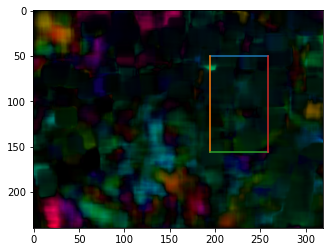

[2, 1, 195, 50, 259, 156]


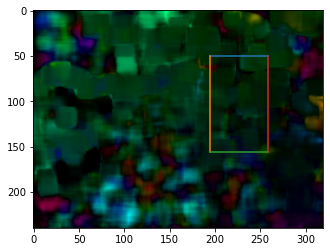

[3, 1, 195, 50, 259, 156]


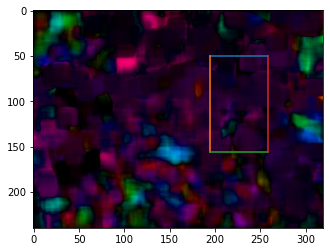

[4, 1, 195, 50, 259, 156]


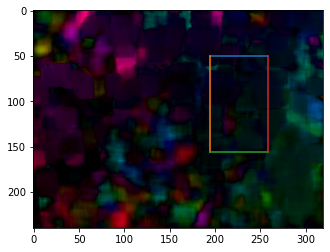

[5, 1, 195, 50, 259, 156]


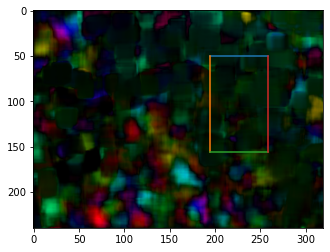

[6, 1, 195, 50, 259, 156]


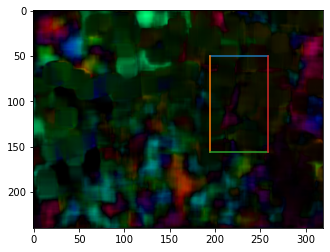

[7, 1, 195, 50, 259, 156]


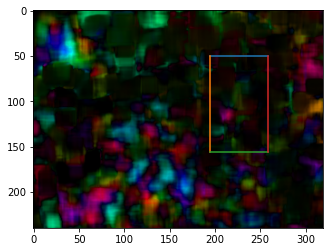

[8, 1, 195, 50, 259, 156]


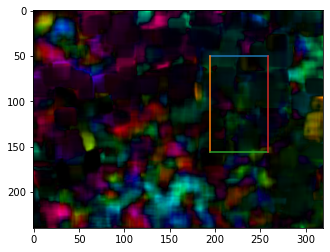

[9, 1, 195, 50, 259, 156]


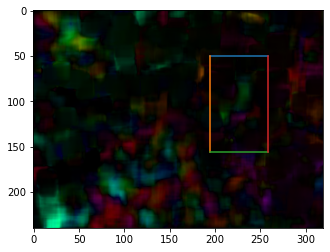

[10, 1, 195, 50, 259, 156]


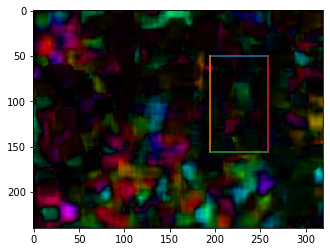

[11, 1, 195, 50, 259, 156]


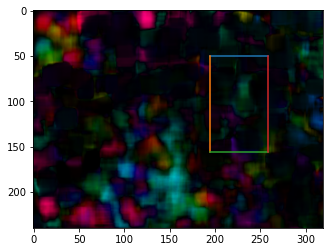

[12, 1, 195, 50, 259, 156]


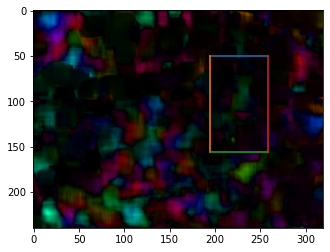

[13, 1, 195, 50, 259, 156]


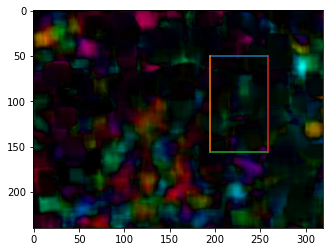

[14, 1, 195, 50, 259, 156]


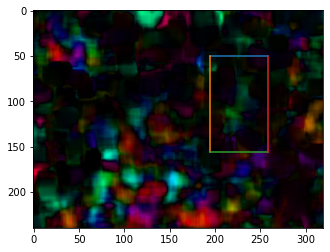

[15, 1, 195, 50, 259, 156]


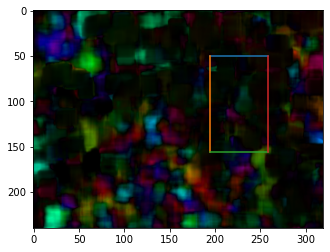

[16, 1, 195, 50, 259, 156]


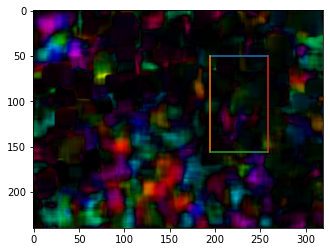

[17, 1, 195, 50, 259, 156]


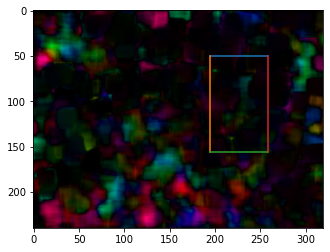

[18, 1, 195, 50, 259, 156]


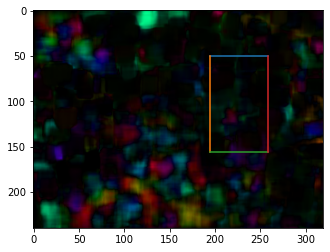

[19, 1, 195, 50, 259, 156]


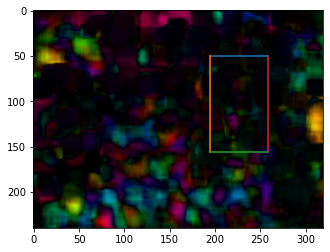

[20, 1, 195, 50, 259, 156]


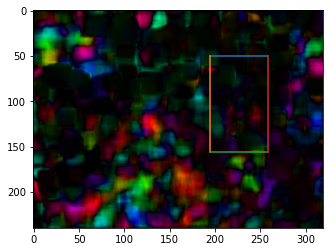

[21, 1, 195, 50, 259, 156]


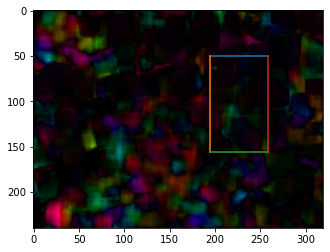

[22, 1, 195, 50, 259, 156]


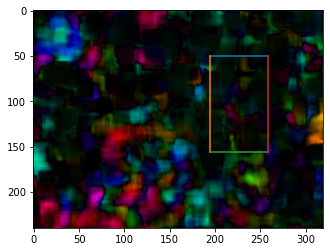

[23, 2, 195, 50, 259, 156]


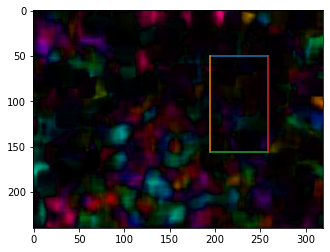

[24, 2, 195, 50, 259, 156]


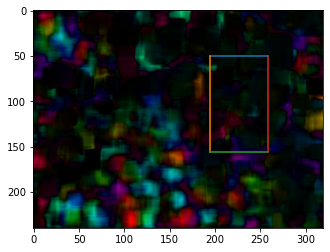

[25, 2, 195, 50, 259, 156]


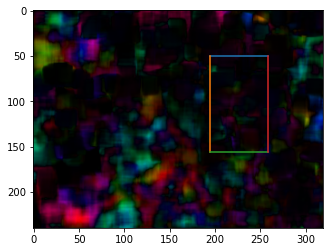

[26, 2, 195, 50, 259, 156]


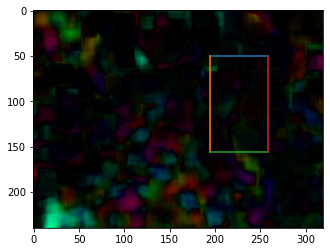

[27, 2, 195, 50, 259, 156]


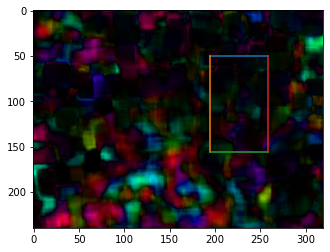

[28, 2, 195, 50, 259, 156]


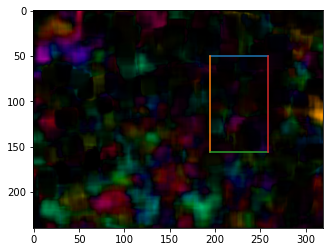

[29, 2, 195, 50, 259, 156]


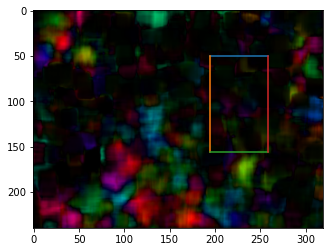

[30, 2, 195, 50, 259, 156]


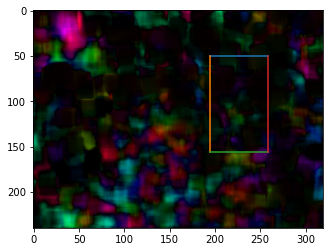

[31, 2, 195, 50, 259, 156]


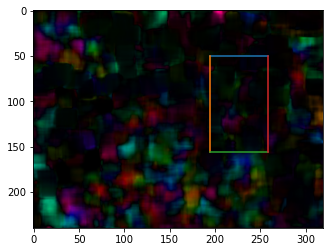

[32, 2, 195, 50, 259, 156]


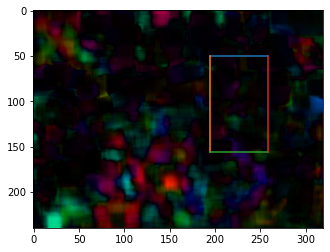

[33, 2, 195, 50, 259, 156]


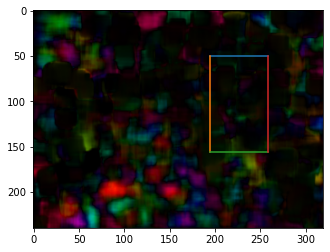

[34, 2, 195, 50, 259, 156]


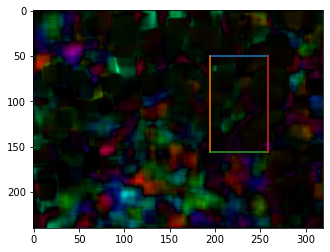

[35, 2, 195, 50, 259, 156]


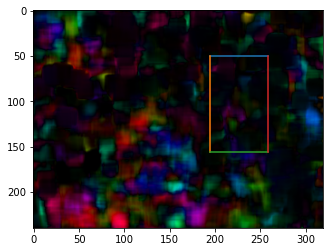

[36, 2, 195, 46, 260, 153]


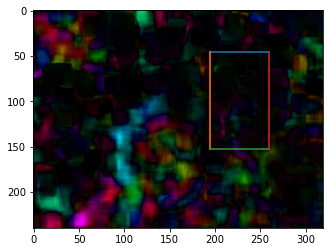

[37, 2, 195, 46, 260, 153]


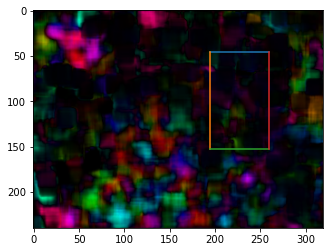

[38, 2, 195, 46, 260, 153]


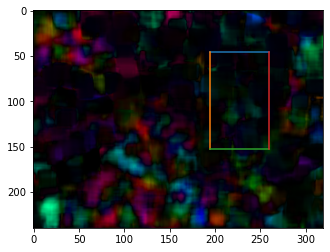

[39, 2, 195, 46, 260, 153]


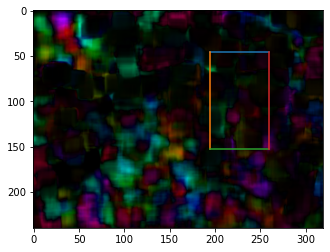

[40, 2, 195, 46, 260, 153]


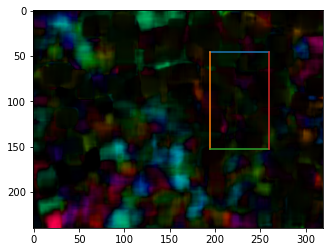

[41, 2, 195, 46, 260, 153]


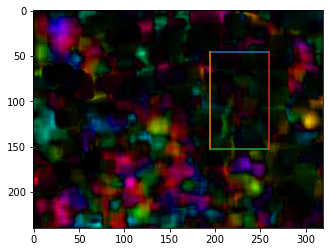

[42, 2, 195, 46, 260, 153]


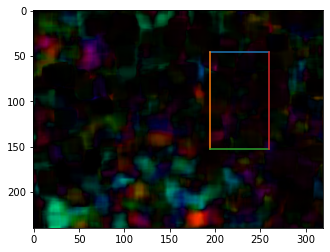

[43, 2, 195, 46, 260, 153]


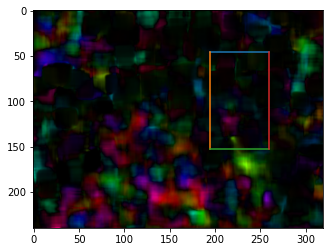

[44, 2, 195, 46, 260, 153]


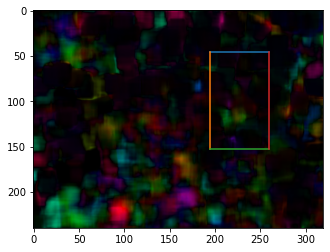

[45, 2, 195, 46, 260, 153]


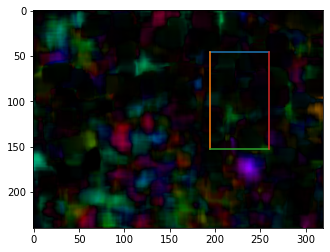

[46, 2, 195, 46, 260, 153]


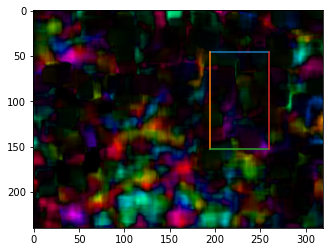

[47, 2, 195, 46, 260, 153]


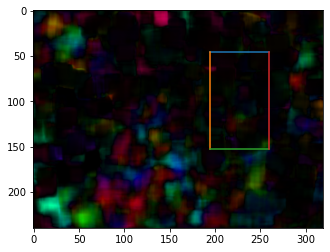

[48, 2, 195, 46, 260, 153]


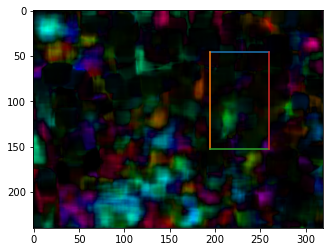

[49, 2, 195, 46, 260, 153]


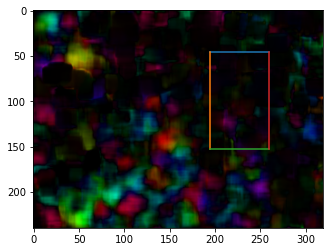

[50, 2, 195, 46, 260, 153]


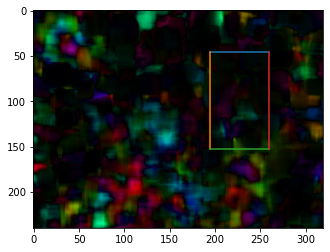

[51, 2, 195, 46, 260, 153]


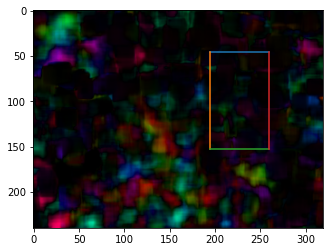

[52, 2, 195, 46, 260, 153]


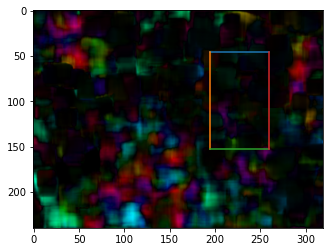

[53, 2, 195, 46, 260, 153]


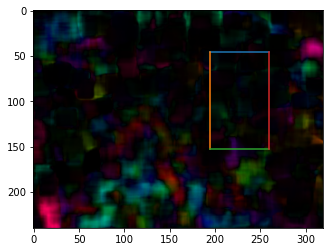

[54, 2, 195, 46, 260, 153]


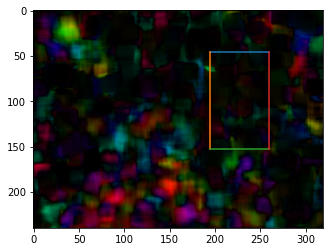

[55, 2, 195, 46, 260, 153]


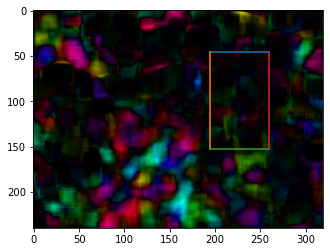

[56, 2, 195, 46, 260, 153]


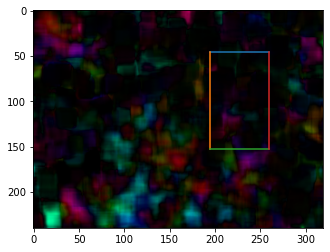

[57, 2, 195, 46, 260, 153]


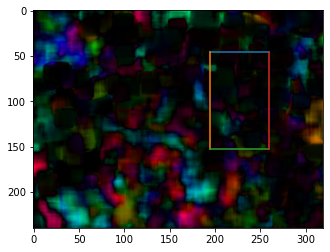

[58, 2, 195, 46, 260, 153]


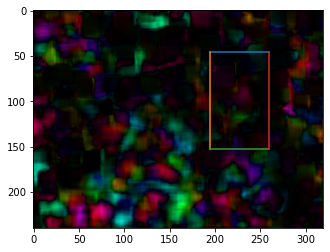

[59, 2, 195, 46, 260, 153]


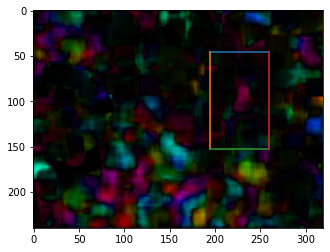

[60, 2, 195, 46, 260, 153]


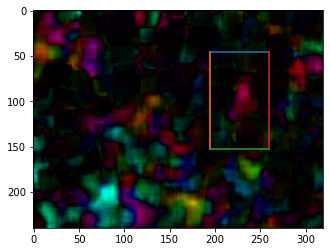

[61, 2, 195, 46, 260, 153]


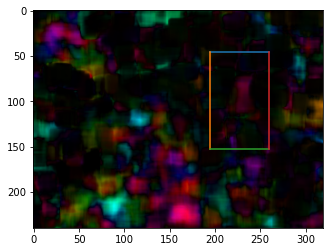

[62, 2, 195, 46, 260, 153]


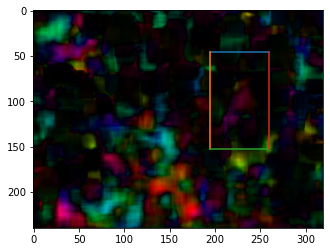

[63, 2, 195, 46, 260, 153]


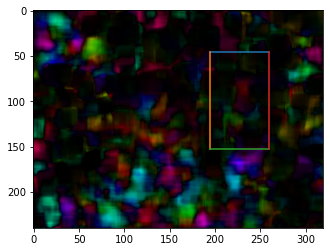

[64, 2, 195, 46, 260, 153]


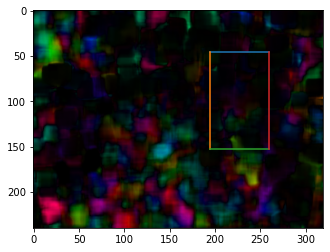

[65, 2, 195, 46, 260, 153]


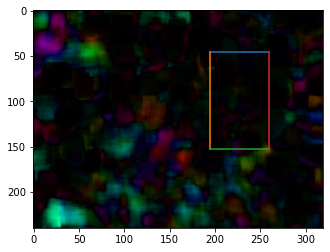

[66, 2, 195, 46, 260, 153]


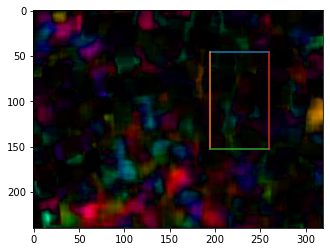

[67, 2, 195, 46, 260, 153]


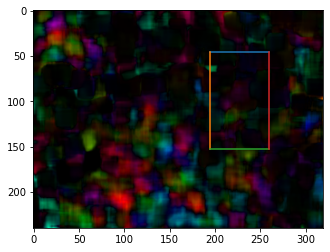

[68, 2, 195, 46, 260, 153]


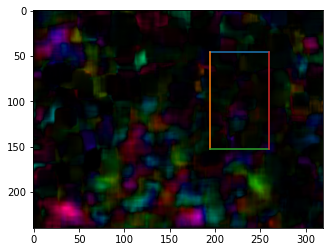

[69, 2, 195, 46, 260, 153]


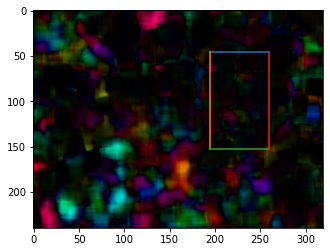

[70, 2, 195, 46, 260, 153]


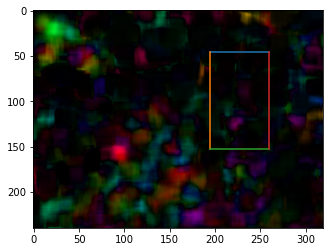

[71, 2, 195, 46, 260, 153]


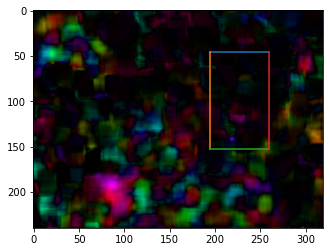

[72, 2, 195, 46, 260, 153]


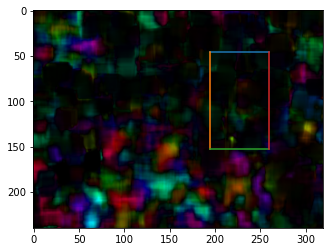

[73, 2, 195, 46, 260, 153]


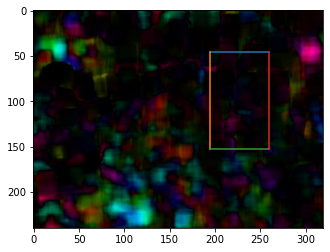

[74, 2, 195, 46, 260, 153]


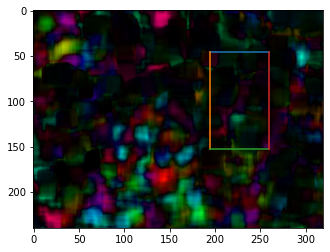

[75, 2, 191, 49, 264, 155]


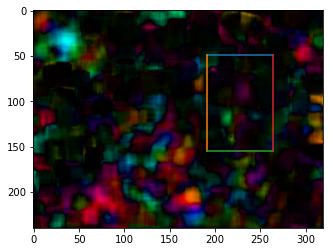

[76, 2, 191, 49, 264, 155]


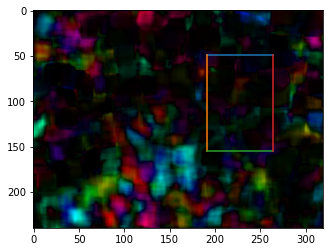

[77, 2, 191, 49, 264, 155]


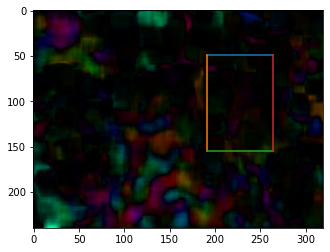

[78, 2, 191, 49, 264, 155]


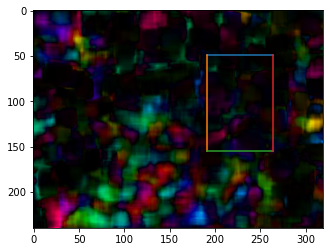

[79, 2, 191, 49, 264, 155]


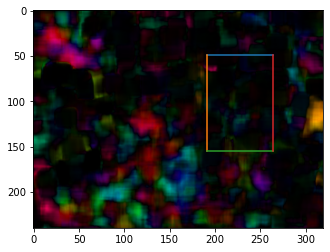

[80, 2, 191, 49, 264, 155]


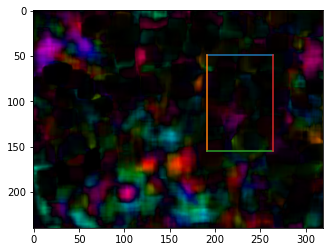

[81, 2, 191, 49, 264, 155]


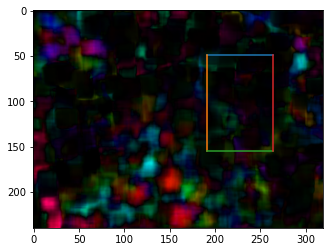

[82, 2, 191, 49, 264, 155]


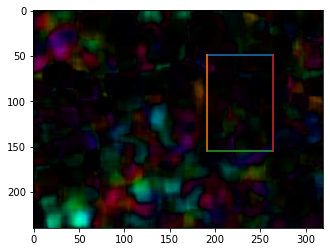

[83, 2, 191, 49, 264, 155]


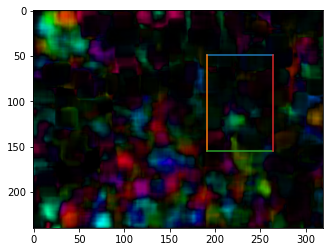

[84, 2, 191, 49, 264, 155]


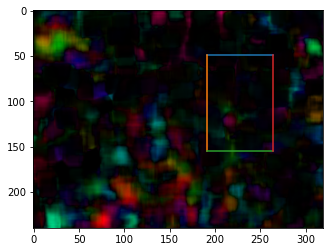

[85, 2, 191, 49, 264, 155]


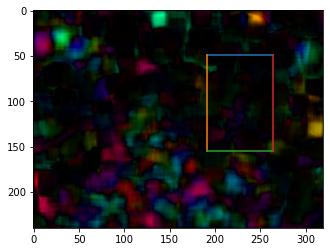

[86, 2, 191, 49, 264, 155]


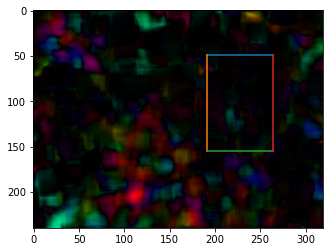

[87, 2, 191, 49, 264, 155]


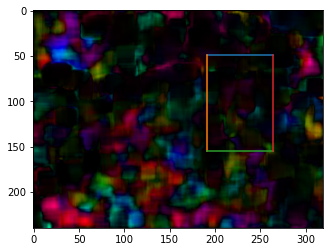

[88, 2, 191, 49, 264, 155]


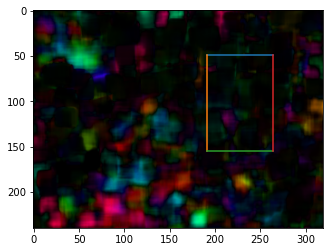

[89, 1, 196, 46, 255, 156]


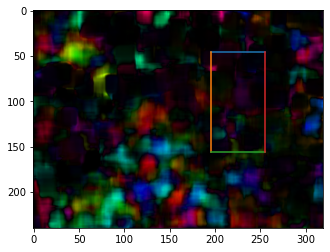

[90, 1, 196, 46, 255, 156]


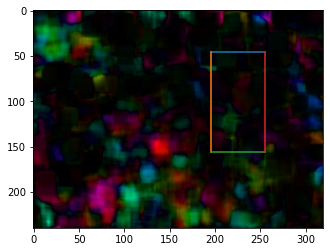

[91, 1, 196, 46, 255, 156]


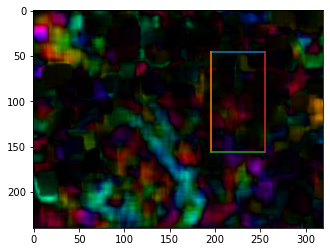

[92, 1, 196, 46, 255, 156]


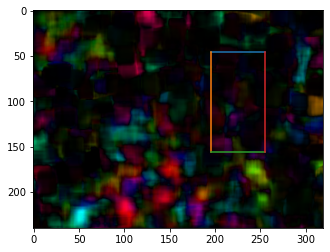

[93, 1, 196, 46, 255, 156]


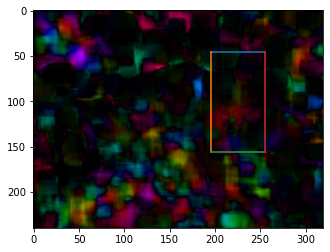

[94, 1, 196, 46, 255, 156]


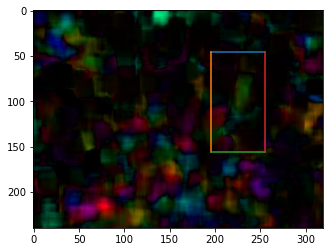

[95, 1, 196, 46, 255, 156]


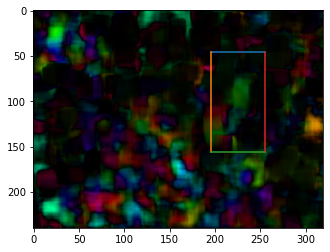

[96, 1, 196, 46, 255, 156]


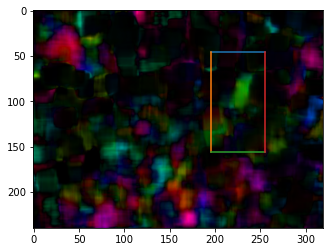

[97, 1, 196, 46, 255, 156]


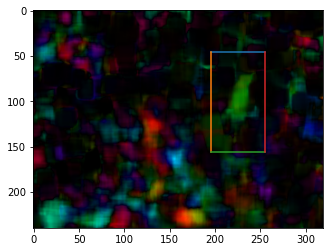

[98, 1, 196, 46, 255, 156]


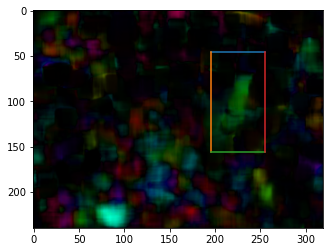

[99, 1, 193, 50, 256, 149]


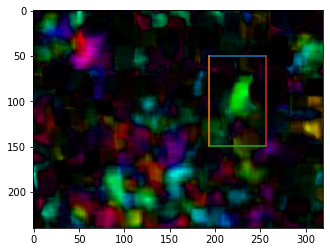

[100, 1, 193, 50, 256, 149]


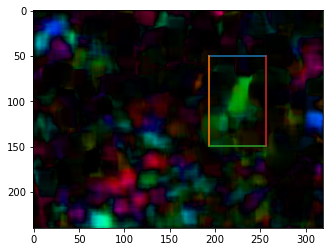

[101, 1, 193, 50, 256, 149]


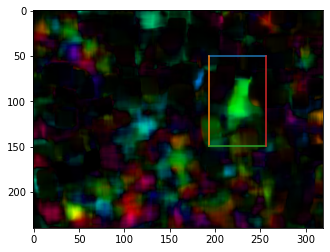

[102, 1, 193, 50, 256, 149]


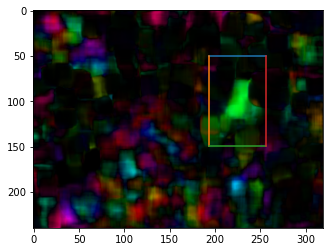

[103, 1, 193, 50, 256, 149]


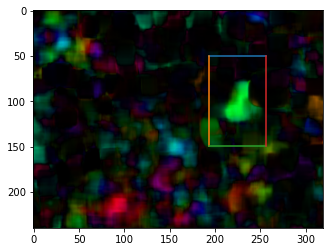

[104, 1, 193, 50, 256, 149]


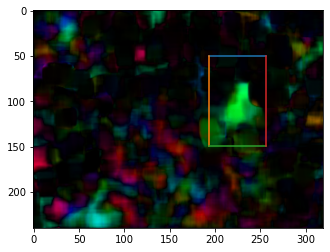

[105, 1, 193, 50, 256, 149]


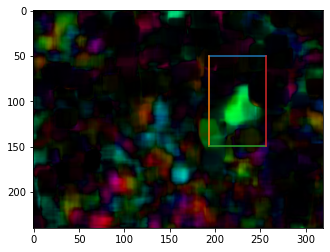

[106, 1, 193, 50, 256, 149]


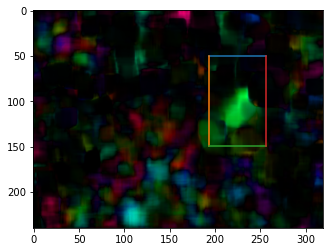

[107, 1, 193, 50, 256, 149]


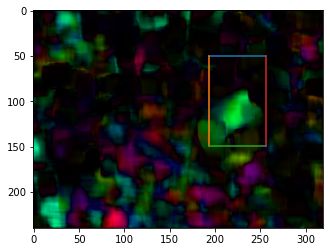

[108, 1, 193, 50, 256, 149]


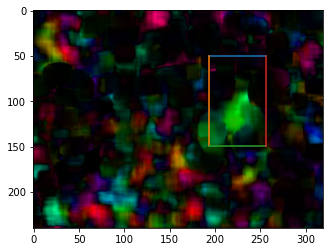

[109, 1, 193, 50, 256, 149]


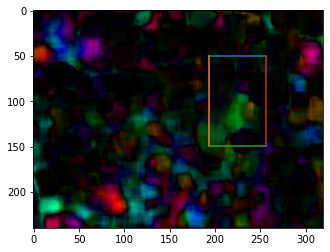

[110, 1, 193, 50, 256, 149]


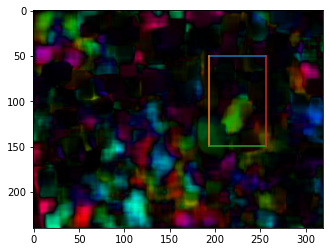

[111, 1, 181, 66, 262, 156]


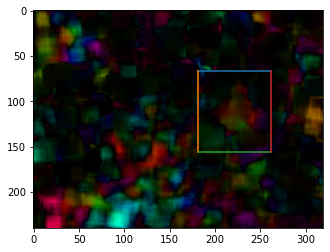

[112, 1, 181, 66, 262, 156]


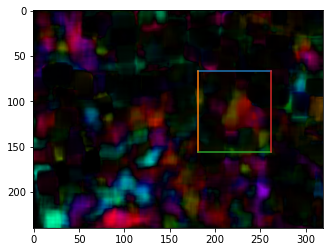

[113, 1, 181, 66, 262, 156]


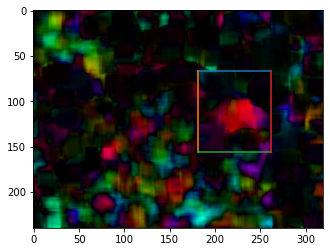

[114, 1, 181, 66, 262, 156]


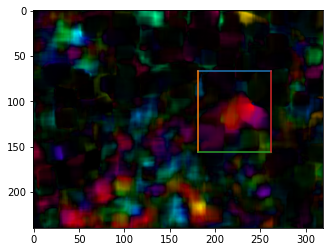

[115, 1, 181, 66, 262, 156]


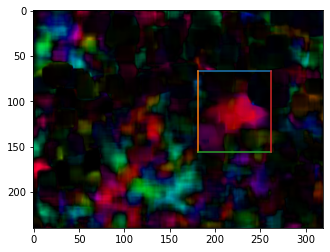

[116, 1, 181, 66, 262, 156]


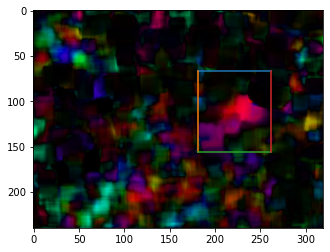

[117, 1, 181, 66, 262, 156]


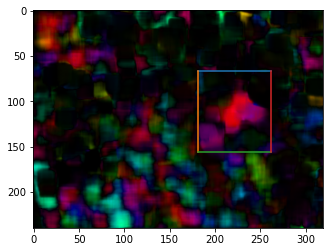

[118, 1, 187, 55, 262, 161]


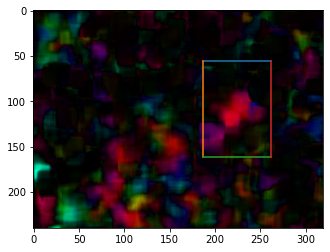

[119, 1, 187, 55, 262, 161]


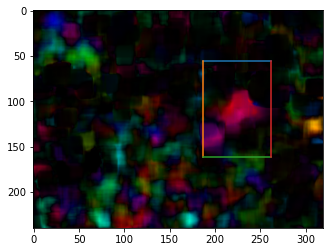

[120, 1, 187, 55, 262, 161]


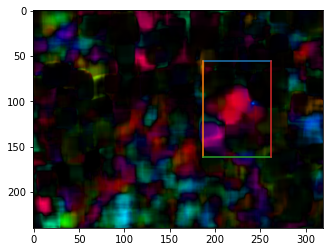

[121, 1, 187, 55, 262, 161]


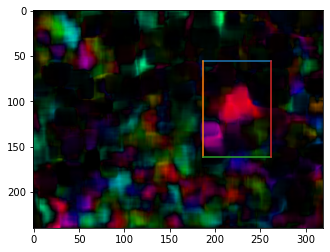

[122, 1, 187, 55, 262, 161]


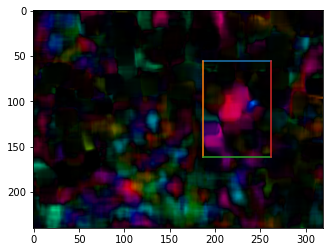

[123, 1, 187, 55, 262, 161]


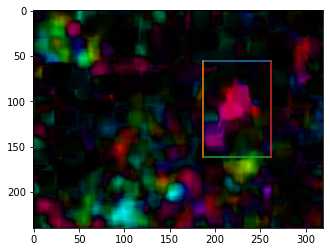

[124, 1, 181, 50, 258, 156]


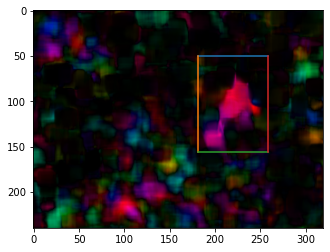

[125, 1, 181, 50, 258, 156]


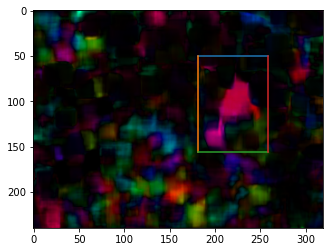

[126, 1, 181, 50, 258, 156]


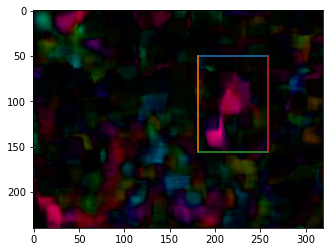

[127, 1, 181, 50, 258, 156]


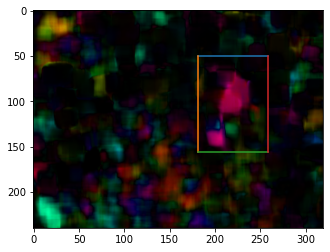

[128, 1, 181, 50, 258, 156]


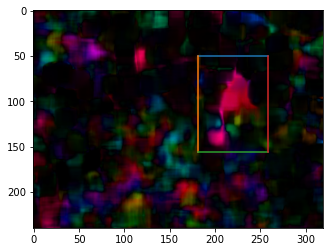

[129, 1, 186, 42, 269, 156]


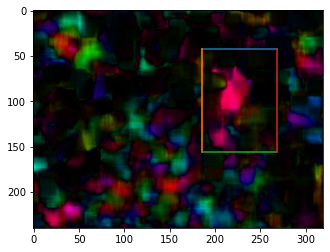

[130, 1, 186, 42, 269, 156]


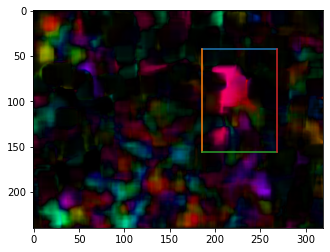

[131, 1, 186, 42, 269, 156]


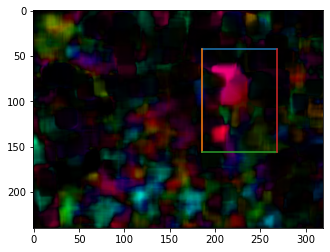

[132, 1, 186, 42, 269, 156]


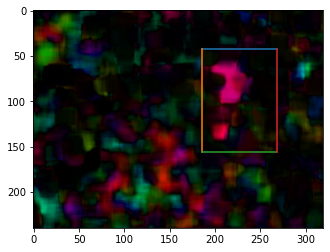

[133, 1, 186, 42, 269, 156]


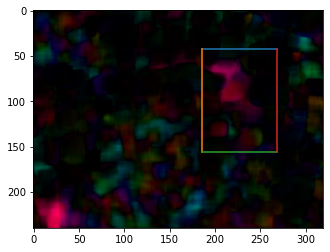

[134, 1, 186, 42, 269, 156]


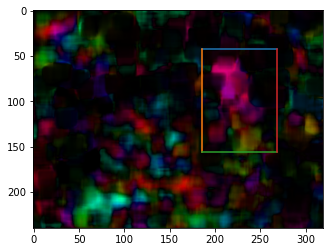

[135, 1, 185, 30, 256, 158]


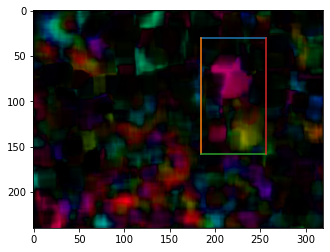

[136, 1, 185, 30, 256, 158]


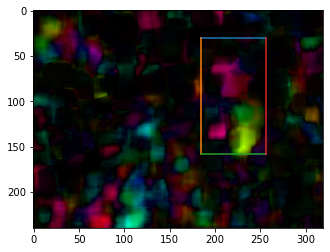

[137, 1, 185, 30, 256, 158]


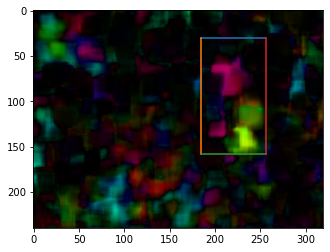

[138, 1, 185, 30, 256, 158]


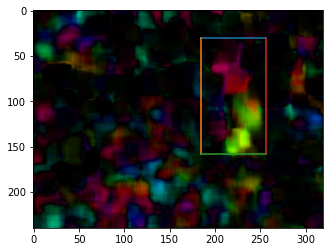

[139, 1, 185, 30, 256, 158]


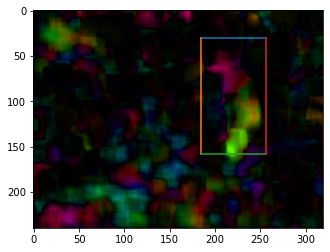

[140, 1, 185, 30, 256, 158]


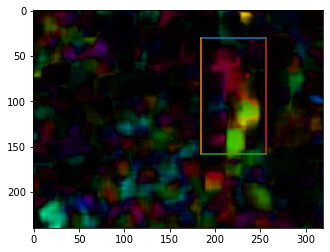

[141, 1, 187, 25, 244, 159]


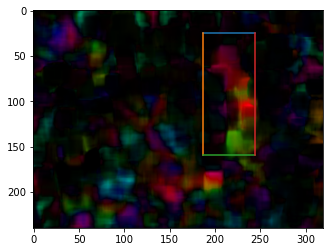

[142, 1, 187, 25, 244, 159]


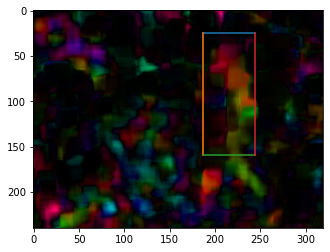

[143, 1, 187, 25, 244, 159]


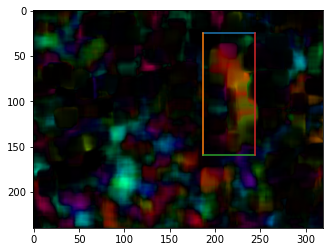

[144, 1, 187, 25, 244, 159]


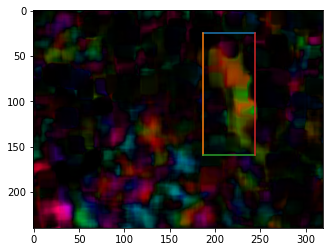

[145, 1, 187, 25, 244, 159]


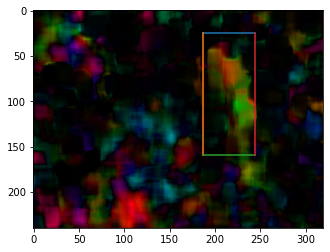

[146, 1, 179, 23, 241, 157]


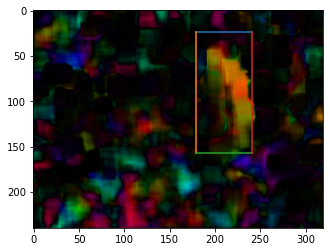

[147, 1, 179, 23, 241, 157]


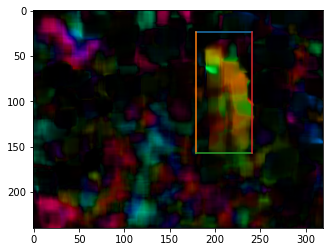

[148, 1, 179, 23, 241, 157]


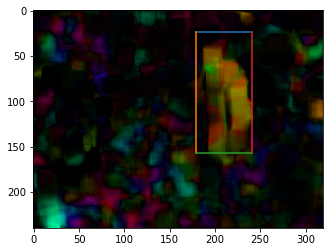

[149, 1, 179, 23, 241, 157]


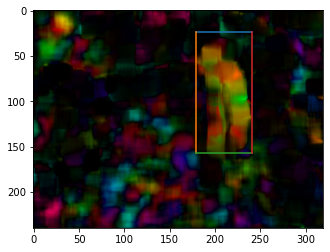

[150, 1, 179, 23, 241, 157]


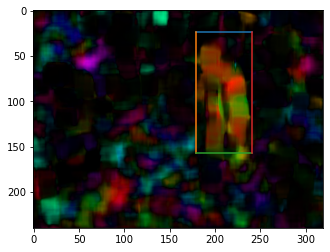

[151, 1, 182, 17, 244, 156]


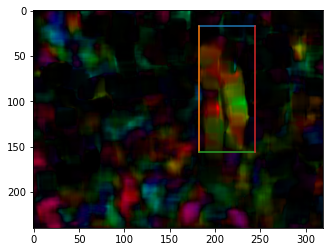

[152, 1, 182, 17, 244, 156]


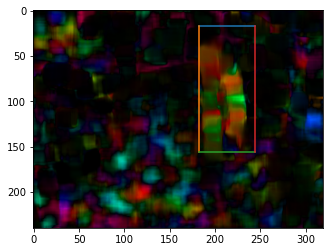

[153, 1, 182, 17, 244, 156]


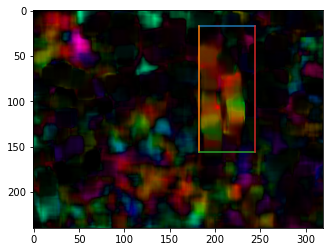

[154, 1, 182, 17, 244, 156]


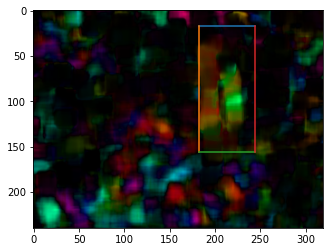

[155, 1, 182, 17, 244, 156]


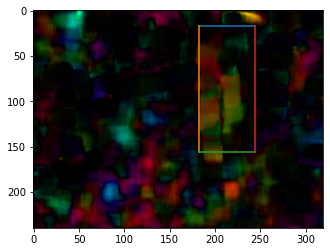

[156, 1, 182, 17, 244, 156]


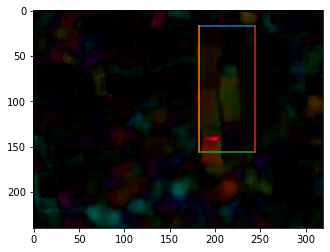

[157, 1, 182, 17, 244, 156]


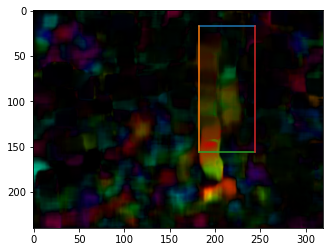

[158, 1, 162, 19, 227, 165]


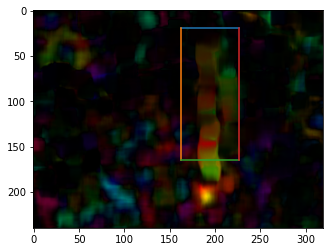

[159, 1, 162, 19, 227, 165]


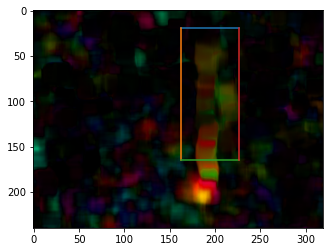

[160, 1, 162, 19, 227, 165]


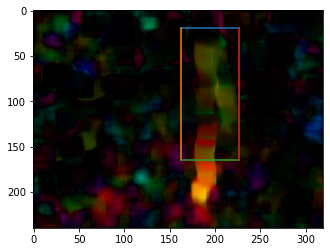

[161, 1, 162, 19, 227, 165]


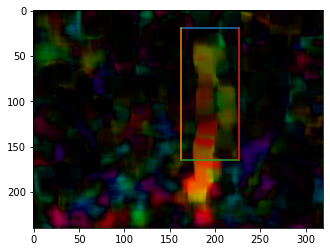

[162, 1, 162, 19, 227, 165]


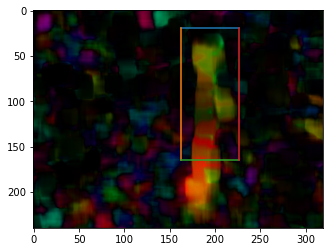

[163, 1, 162, 19, 227, 165]


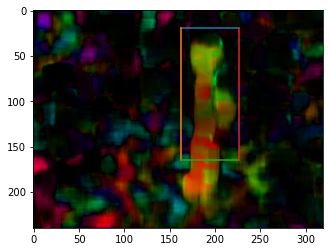

[164, 1, 162, 19, 227, 165]


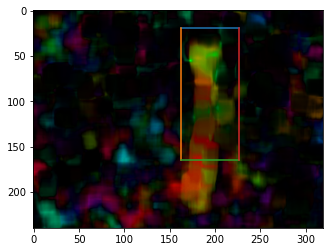

[165, 1, 147, 16, 233, 169]


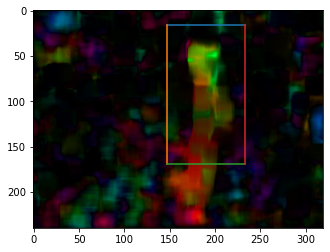

[166, 1, 147, 16, 233, 169]


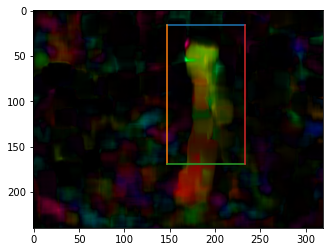

[167, 1, 147, 16, 233, 169]


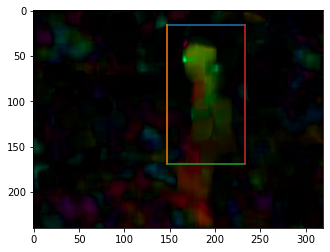

[168, 1, 147, 16, 233, 169]


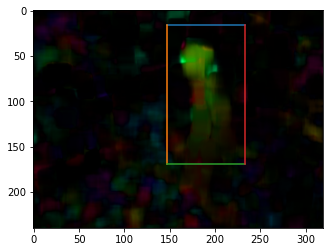

[169, 1, 147, 16, 233, 169]


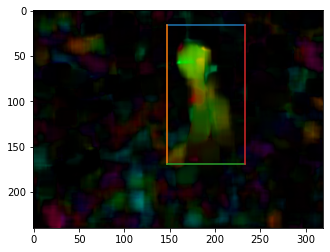

[170, 1, 144, 22, 228, 151]


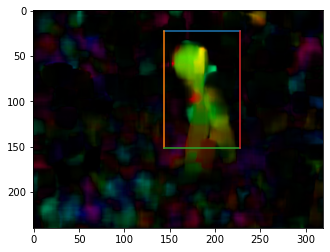

[171, 8, 149, 24, 231, 165]


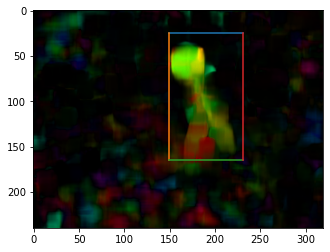

[172, 8, 149, 24, 231, 165]


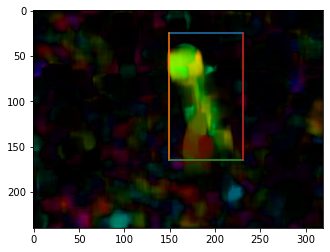

[173, 8, 149, 24, 231, 165]


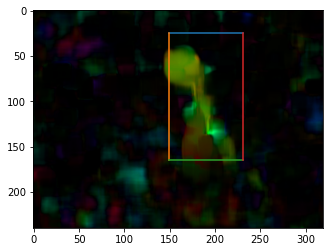

[174, 8, 130, 35, 227, 147]


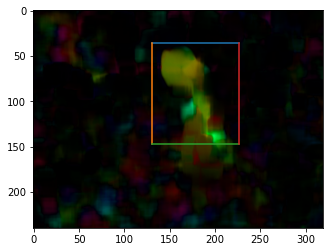

[175, 8, 130, 35, 227, 147]


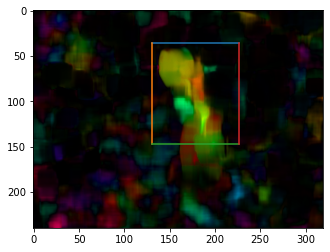

[176, 8, 130, 35, 227, 147]


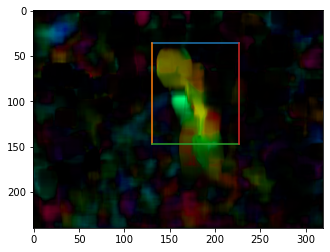

[177, 8, 115, 34, 217, 151]


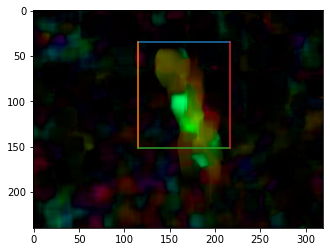

[178, 8, 115, 34, 217, 151]


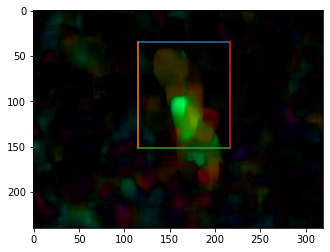

[179, 8, 115, 34, 217, 151]


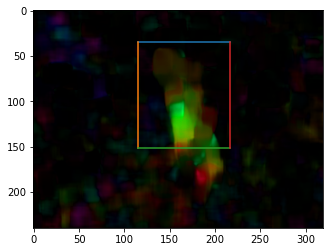

[180, 8, 115, 34, 217, 151]


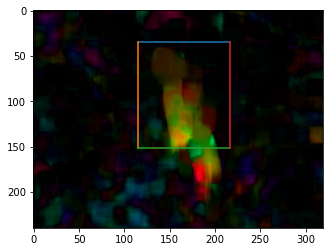

[181, 8, 115, 34, 217, 151]


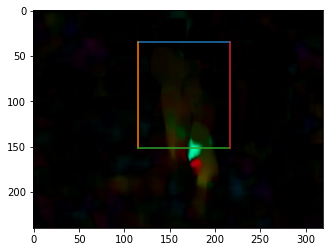

[182, 8, 115, 22, 202, 147]


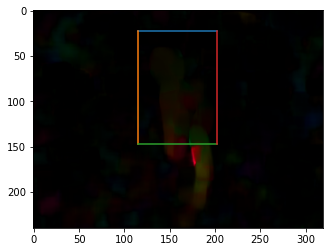

[183, 8, 115, 22, 202, 147]


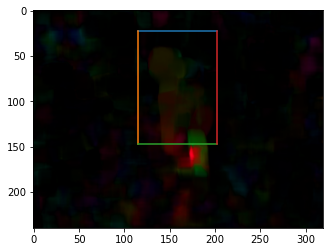

[184, 8, 115, 22, 202, 147]


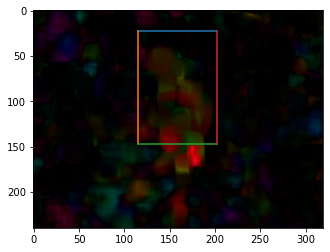

[185, 8, 115, 22, 202, 147]


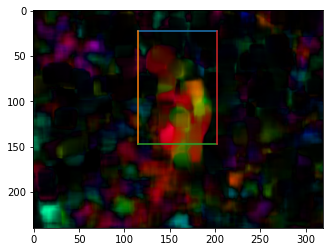

[186, 8, 115, 22, 202, 147]


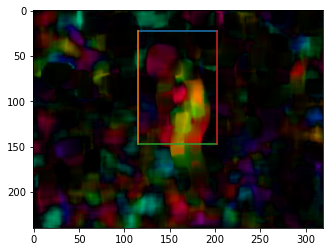

[187, 8, 115, 22, 202, 147]


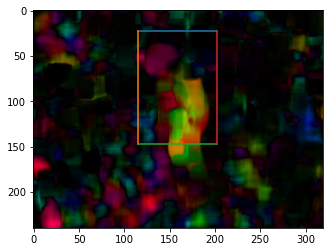

[188, 8, 115, 22, 202, 147]


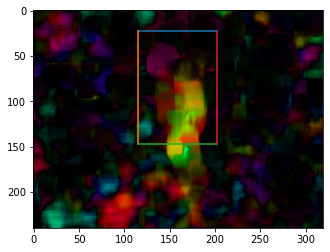

[189, 8, 113, 20, 205, 147]


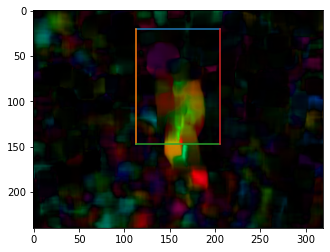

[190, 8, 113, 20, 205, 147]


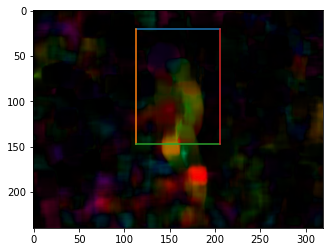

[191, 8, 113, 20, 205, 147]


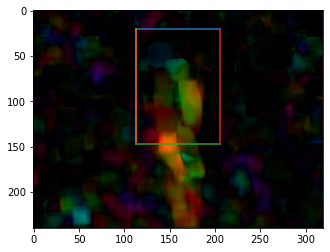

[192, 8, 113, 20, 205, 147]


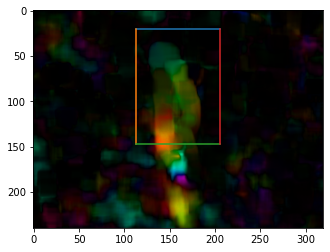

[193, 8, 113, 20, 205, 147]


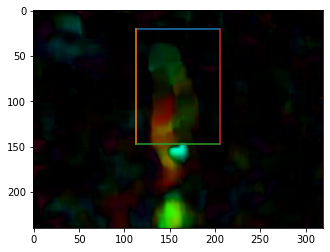

[194, 8, 113, 20, 205, 147]


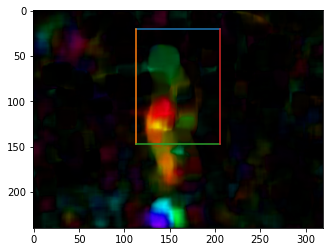

[195, 8, 113, 20, 205, 147]


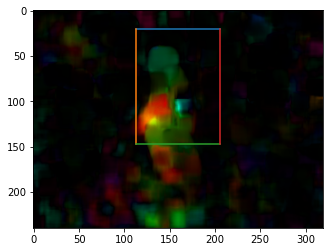

[196, 8, 100, 26, 195, 151]


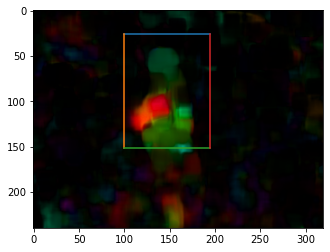

[197, 8, 100, 26, 195, 151]


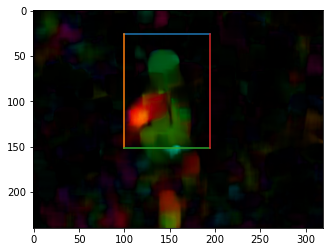

[198, 8, 100, 26, 195, 151]


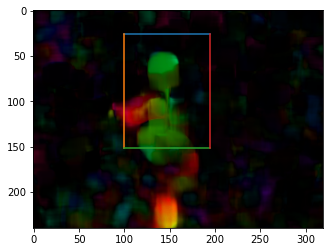

[199, 8, 100, 26, 195, 151]


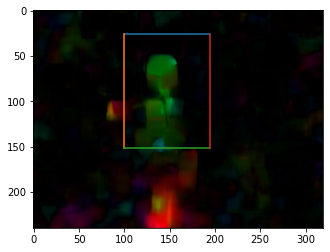

[200, 8, 100, 26, 195, 151]


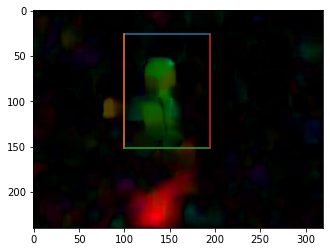

[201, 8, 63, 40, 204, 144]


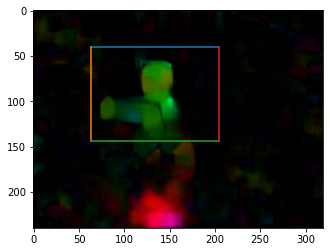

[202, 8, 63, 40, 204, 144]


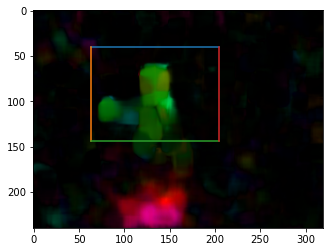

[203, 8, 63, 40, 204, 144]


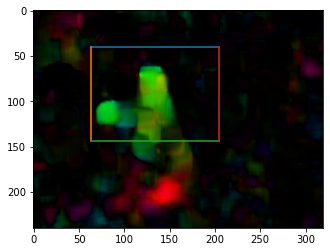

[204, 8, 63, 40, 204, 144]


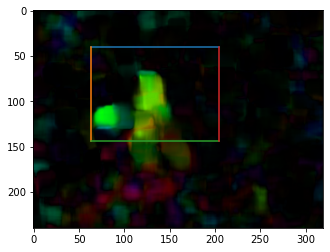

[205, 8, 63, 47, 195, 143]


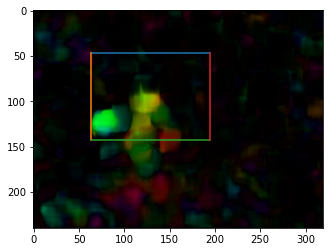

[206, 8, 63, 47, 195, 143]


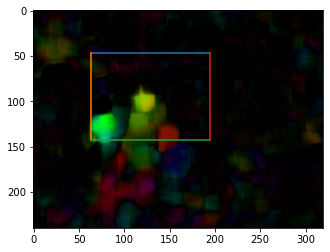

[207, 8, 63, 47, 195, 143]


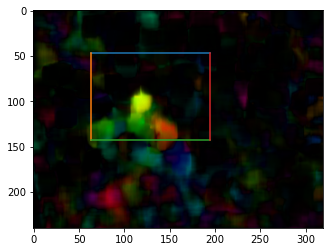

[208, 8, 43, 49, 179, 140]


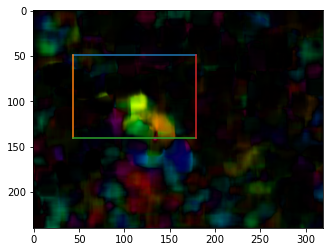

[209, 8, 43, 49, 179, 140]


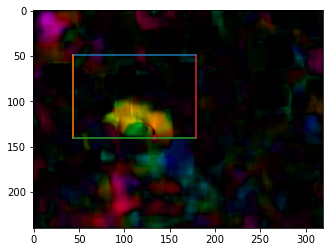

[210, 8, 43, 49, 179, 140]


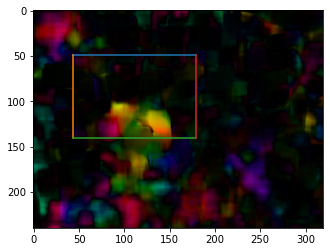

[211, 8, 43, 49, 179, 140]


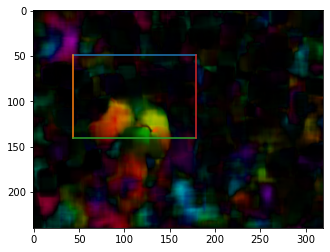

[212, 8, 43, 49, 179, 140]


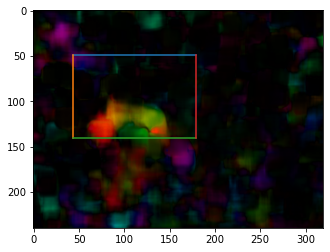

[213, 8, 43, 49, 179, 140]


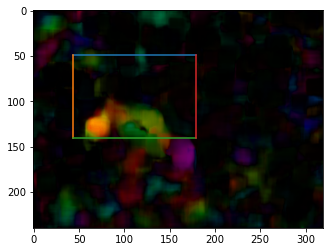

[214, 8, 41, 51, 177, 138]


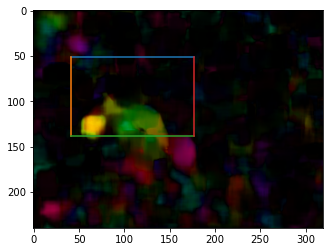

[215, 8, 41, 51, 177, 138]


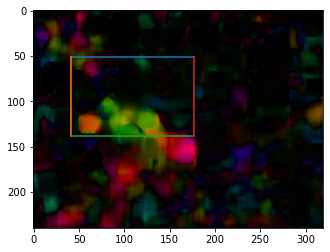

[216, 8, 41, 51, 177, 138]


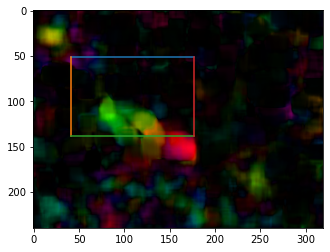

[217, 8, 41, 51, 177, 138]


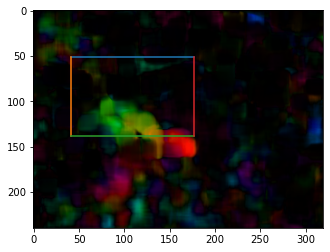

[218, 8, 41, 51, 177, 138]


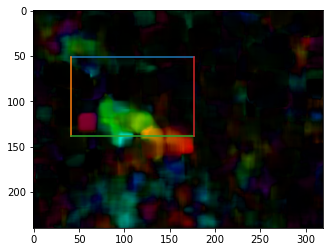

[219, 8, 41, 51, 177, 138]


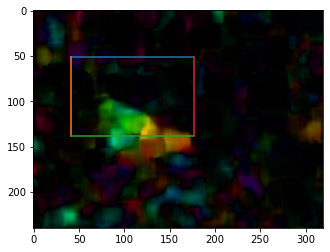

[220, 8, 40, 63, 165, 155]


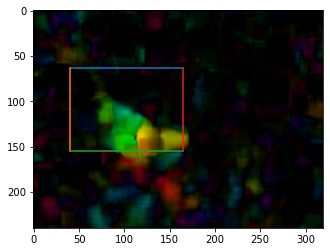

[221, 8, 40, 63, 165, 155]


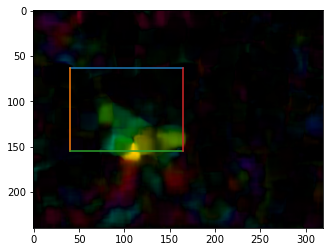

[222, 8, 40, 63, 165, 155]


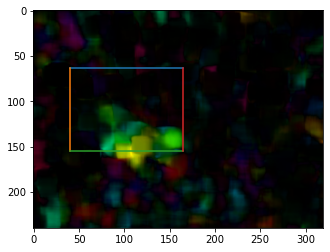

[223, 8, 40, 63, 165, 155]


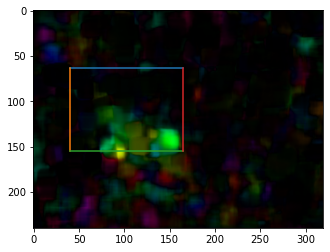

[224, 8, 40, 63, 165, 155]


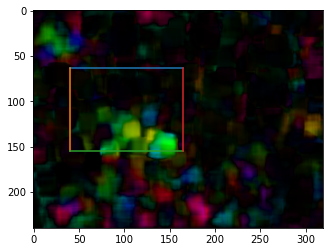

[225, 8, 40, 63, 165, 155]


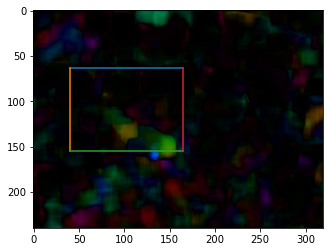

[226, 8, 40, 63, 165, 155]


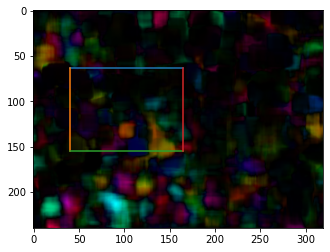

[227, 8, 40, 72, 175, 146]


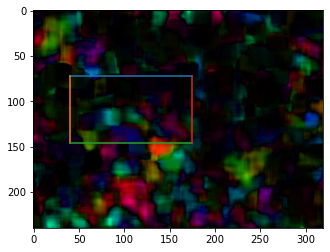

[228, 8, 40, 72, 175, 146]


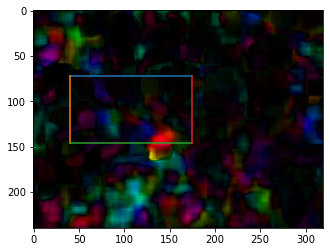

[229, 8, 40, 72, 175, 146]


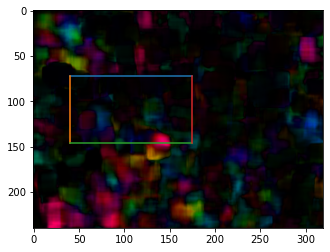

[230, 8, 40, 72, 175, 146]


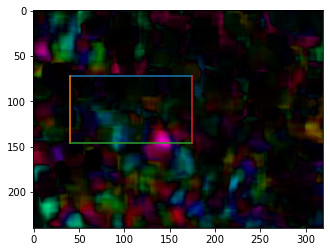

[231, 8, 40, 72, 175, 146]


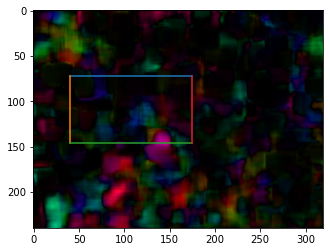

[232, 8, 40, 72, 175, 146]


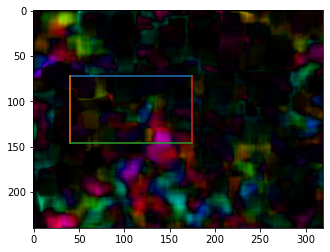

[233, 8, 40, 72, 175, 146]


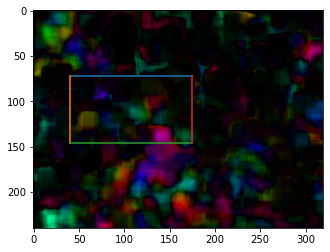

[234, 8, 47, 74, 163, 137]


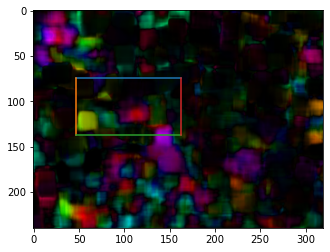

[235, 8, 47, 74, 163, 137]


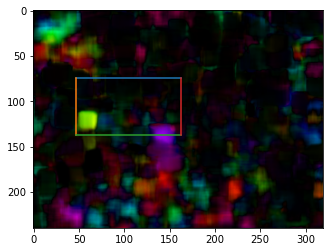

[236, 8, 47, 74, 163, 137]


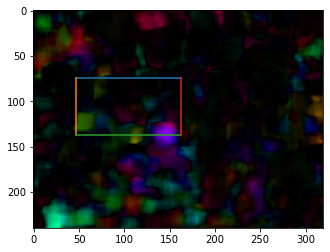

[237, 8, 47, 74, 163, 137]


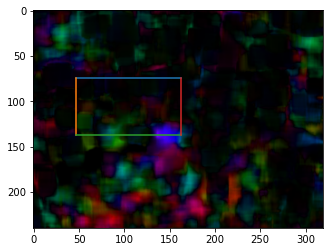

[238, 8, 47, 74, 163, 137]


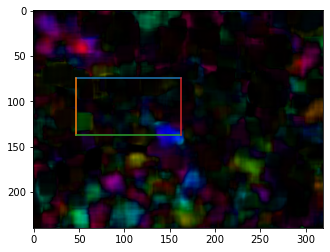

[239, 8, 47, 74, 163, 137]


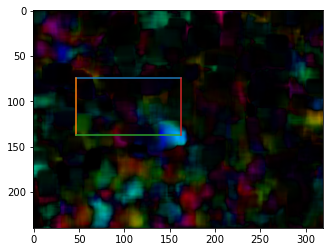

[240, 8, 41, 73, 179, 136]


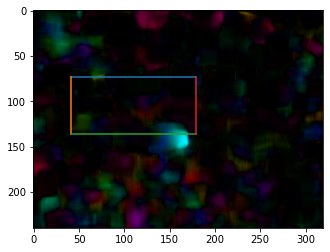

[241, 8, 41, 73, 179, 136]


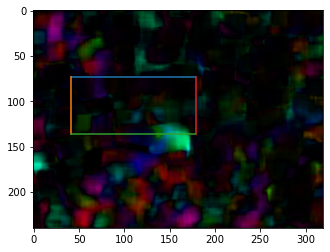

[242, 8, 41, 73, 179, 136]


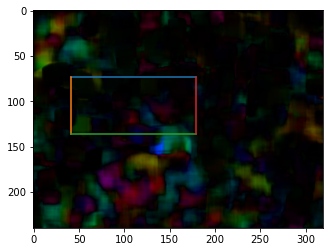

[243, 8, 41, 73, 179, 136]


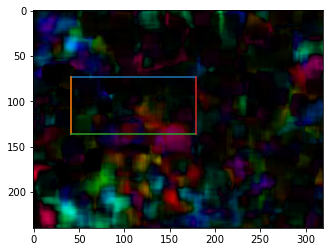

[244, 8, 41, 73, 179, 136]


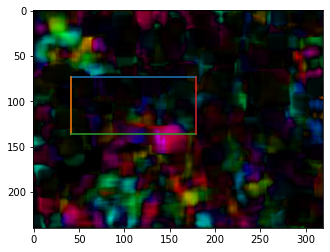

[245, 8, 41, 73, 179, 136]


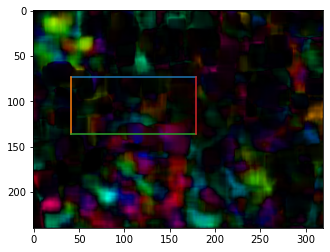

[246, 8, 41, 73, 179, 136]


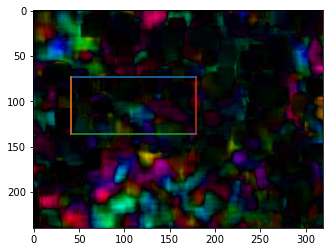

[247, 8, 43, 71, 172, 136]


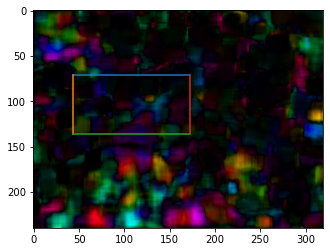

[248, 8, 43, 71, 172, 136]


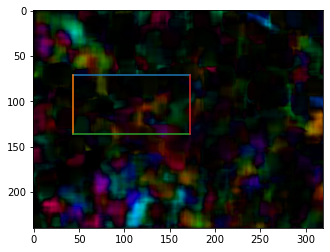

[249, 8, 43, 71, 172, 136]


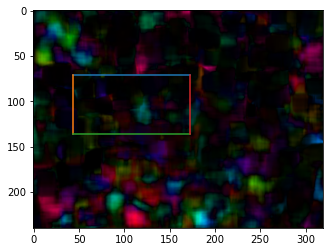

[250, 8, 43, 71, 172, 136]


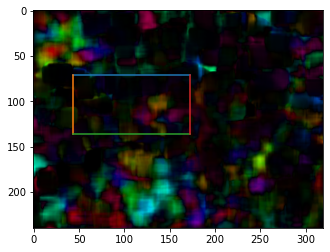

[251, 8, 43, 71, 172, 136]


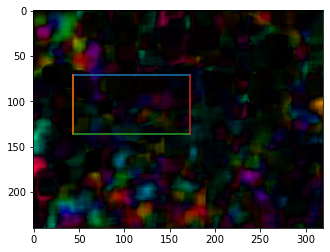

[252, 8, 43, 71, 172, 136]


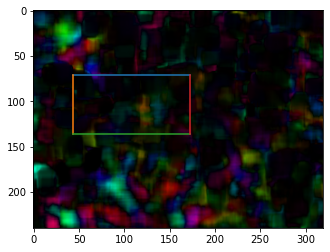

[253, 8, 43, 71, 172, 136]


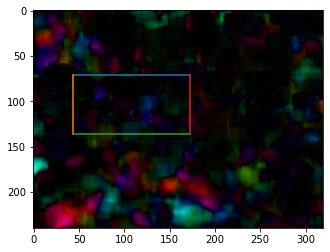

[254, 8, 43, 71, 172, 136]


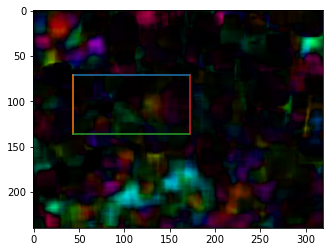

[255, 8, 43, 71, 172, 136]


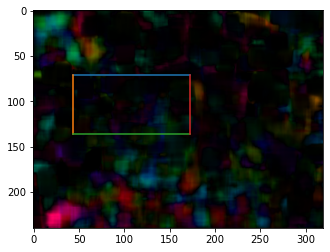

[256, 8, 43, 71, 172, 136]


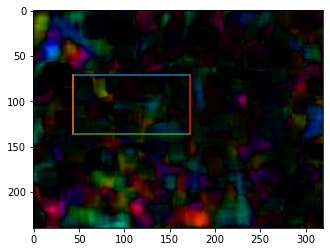

[257, 8, 43, 71, 172, 136]


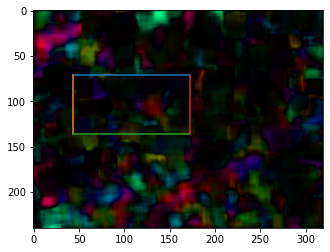

[258, 8, 43, 71, 172, 136]


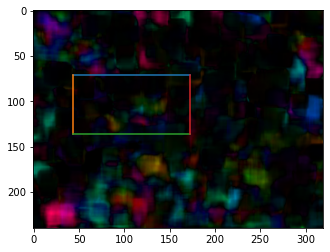

[259, 8, 43, 71, 172, 136]


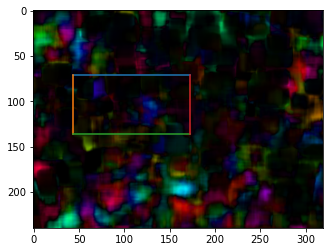

[260, 8, 43, 71, 172, 136]


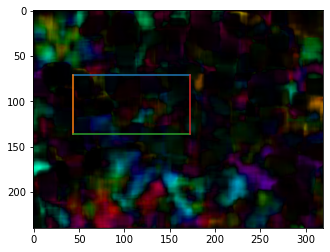

[261, 8, 43, 71, 172, 136]


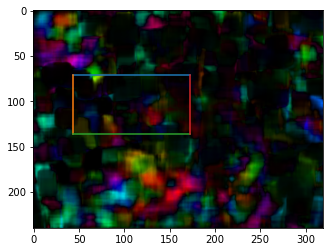

[262, 8, 43, 71, 172, 136]


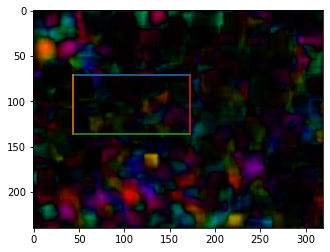

[263, 8, 43, 71, 172, 136]


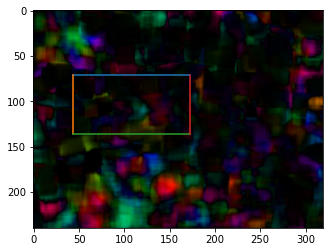

[264, 8, 43, 71, 172, 136]


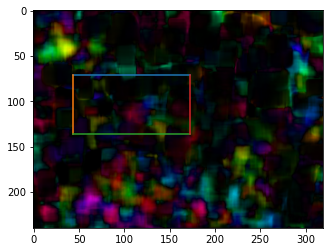

[265, 8, 43, 71, 172, 136]


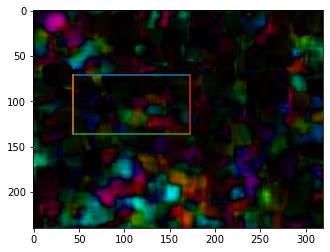

[266, 8, 43, 71, 172, 136]


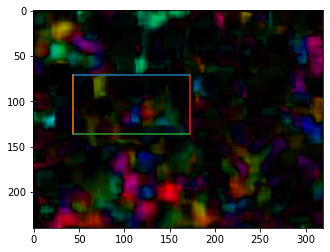

[267, 8, 43, 71, 172, 136]


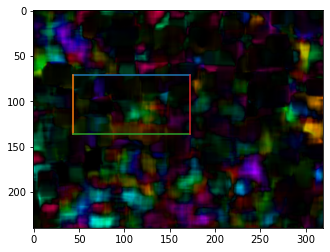

[268, 8, 43, 71, 172, 136]


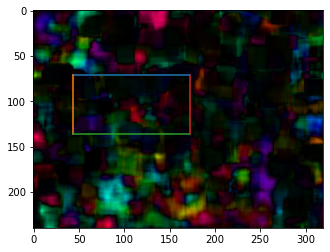

[269, 8, 43, 71, 172, 136]


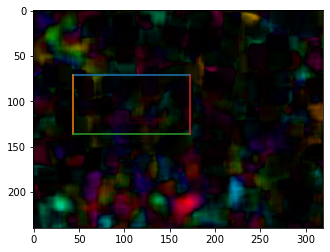

[270, 8, 43, 71, 172, 136]


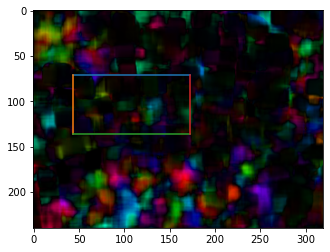

[271, 8, 43, 71, 172, 136]


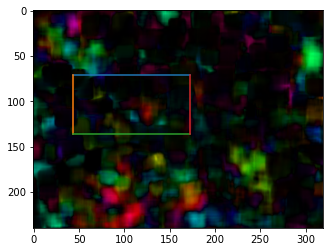

[272, 8, 43, 71, 172, 136]


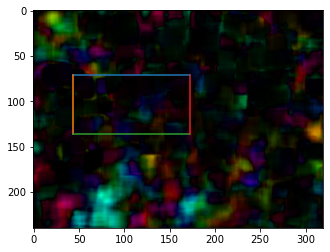

[273, 8, 43, 71, 172, 136]


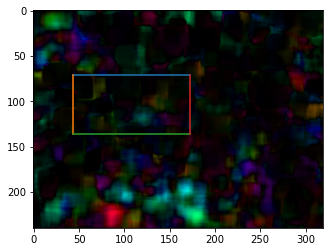

[274, 8, 43, 71, 172, 136]


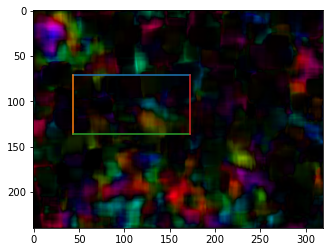

[275, 8, 43, 71, 172, 136]


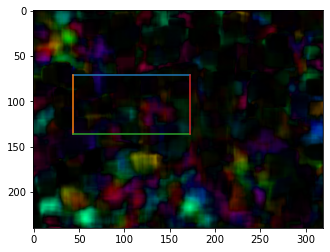

[276, 8, 43, 71, 172, 136]


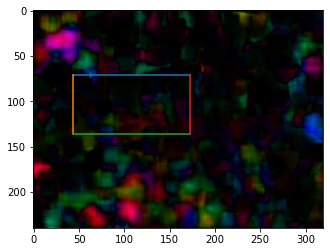

[277, 8, 43, 71, 172, 136]


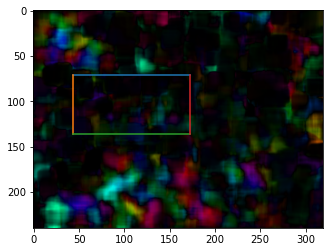

[278, 8, 43, 71, 172, 136]


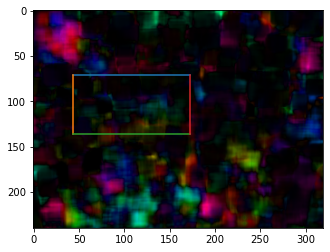

[279, 8, 43, 71, 172, 136]


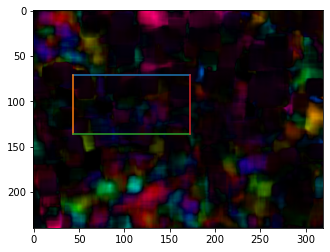

[280, 8, 43, 71, 172, 136]


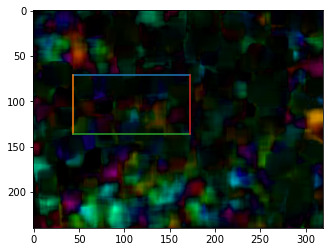

[281, 8, 43, 71, 172, 136]


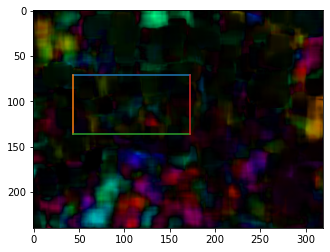

[282, 8, 43, 71, 172, 136]


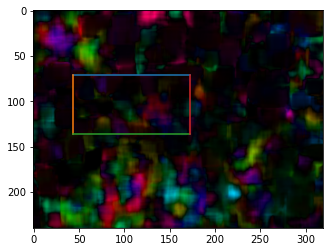

[283, 8, 43, 71, 172, 136]


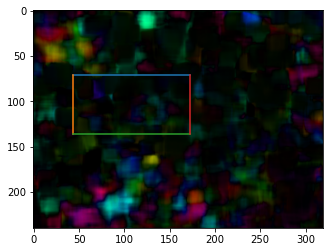

[284, 8, 43, 71, 172, 136]


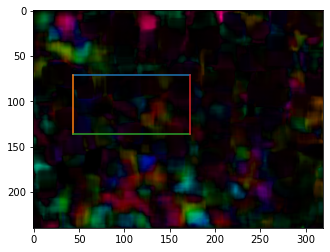

[285, 8, 43, 71, 172, 136]


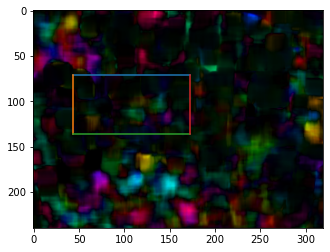

[286, 8, 43, 71, 172, 136]


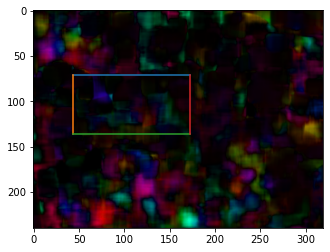

[287, 8, 43, 71, 172, 136]


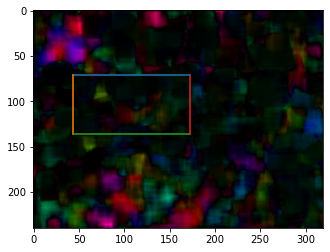

[288, 8, 43, 71, 172, 136]


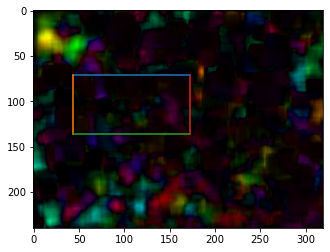

[289, 8, 43, 71, 172, 136]


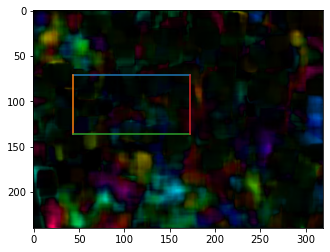

[290, 8, 43, 71, 172, 136]


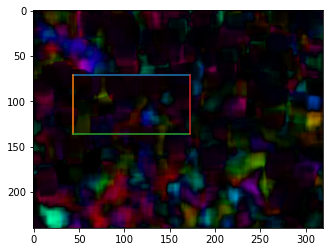

[291, 8, 43, 71, 172, 136]


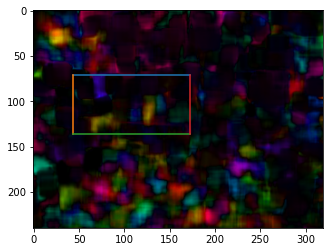

[292, 8, 43, 71, 172, 136]


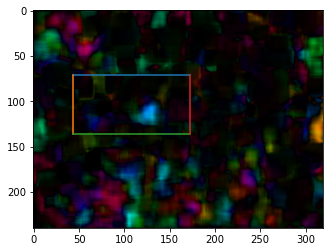

[293, 8, 43, 71, 172, 136]


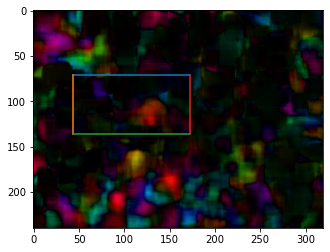

[294, 8, 43, 71, 172, 136]


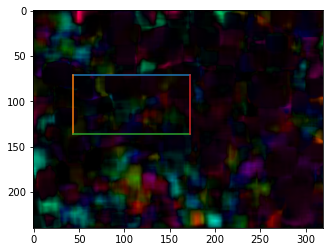

[295, 8, 43, 71, 172, 136]


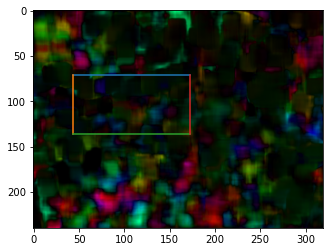

[296, 8, 43, 71, 172, 136]


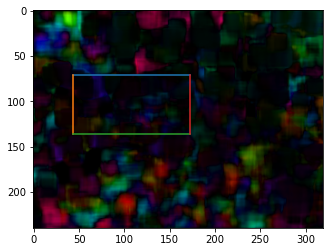

[297, 8, 43, 71, 172, 136]


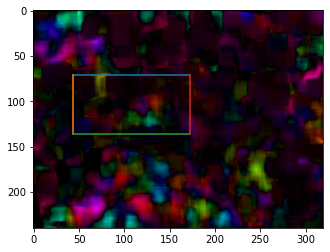

[298, 8, 43, 71, 172, 136]


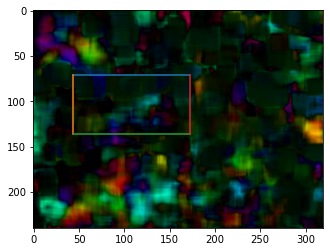

[299, 8, 43, 71, 172, 136]


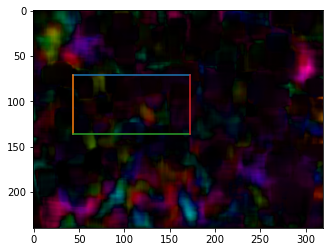

[300, 8, 43, 71, 172, 136]


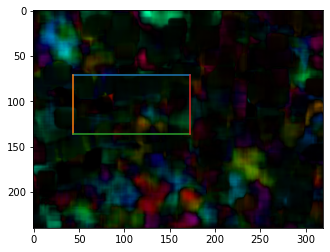

[301, 8, 43, 71, 172, 136]


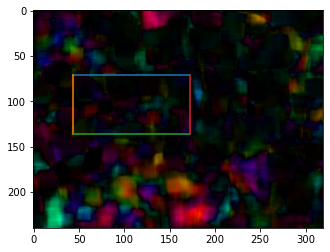

[302, 8, 43, 71, 172, 136]


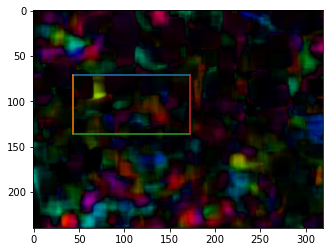

[303, 8, 43, 71, 172, 136]


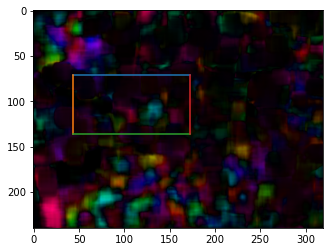

[304, 8, 43, 71, 172, 136]


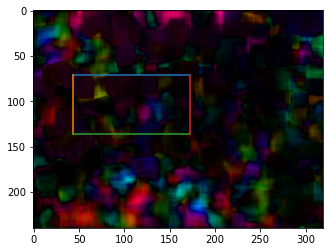

[305, 8, 43, 71, 172, 136]


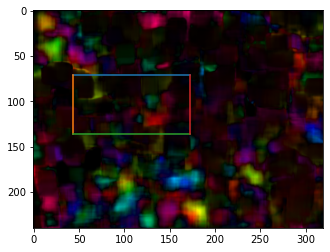

[306, 8, 43, 71, 172, 136]


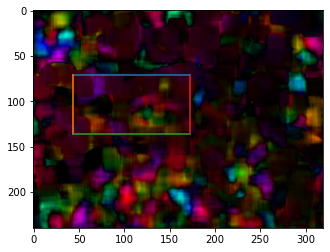

[307, 8, 43, 71, 172, 136]


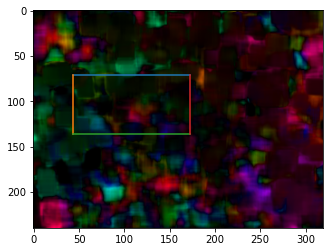

[308, 8, 43, 71, 172, 136]


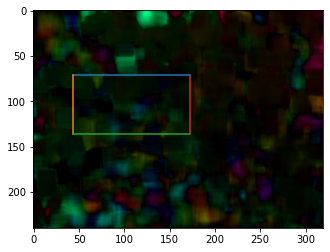

[309, 8, 43, 71, 172, 136]


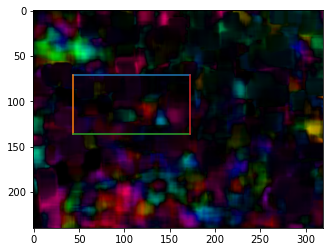

[310, 8, 43, 71, 172, 136]


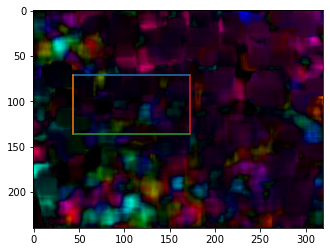

[311, 8, 43, 71, 172, 136]


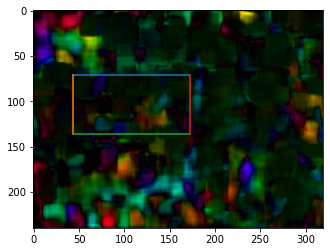

[312, 8, 43, 71, 172, 136]


IndexError: index 312 is out of bounds for axis 0 with size 312

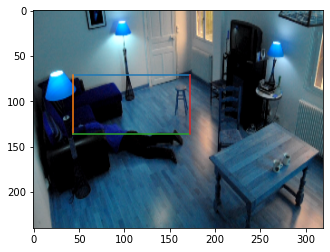

In [15]:
hsv = np.zeros_like(temp[0])
hsv[...,1] = 255
train_x = []
train_y = []

for i,x in enumerate(temp):
    plt.imshow(x)
    t = [int(x) for x in temp_info.iloc[i+2][0].split(',')]
    print(t)
    plt.plot([t[2],t[4]],[t[3],t[3]], c = "b")
    plt.plot([t[2],t[2]],[t[3],t[5]], c = "b")
    plt.plot([t[2],t[4]],[t[5],t[5]], c = "b")
    plt.plot([t[4],t[4]],[t[3],t[5]], c = "b")
    plt.imshow(x)
#     plt.show()
    flow = cv2.calcOpticalFlowFarneback(temp[i][:,:,0], temp[i+1][:,:,0], None, 0.5, 3, 15, 3, 5, 1.2, 0)
    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])
    hsv[...,0] = ang*180/np.pi/2
    hsv[...,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
    bgr = cv2.cvtColor(hsv,cv2.COLOR_HSV2BGR)
    plt.imshow(bgr)
    plt.show()
#     plt.show()

(25, 180, 320, 3)
(240, 320, 3)


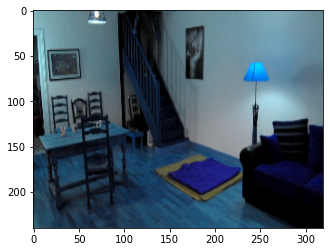

In [110]:
for x in train_x:
    if x.shape!=(25,240,320,3):
        print(x.shape)
        print(cv2.resize(x[0],(320,240)).shape)
        plt.imshow(cv2.resize(x[0],(320,240)))
        break